# Import Libraries

In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

%matplotlib inline

# Camera calibration

In [3]:
nx = 9 # nx: the number of inside corners in x
ny = 6 # ny: the number of inside corners in y

# Array to store object points and image points from all the images

objpoints = [] # 3D points in real world space
imgpoints = [] # 2D points in image plane

# Prepare object points, like (0, 0, 0), (1,0,0),(2,0,0) ......(8,5,0)
objp = np.zeros( (nx*ny,3),np.float32)
# print(objp)
objp[:,:2]=np.mgrid[0:nx,0:ny].T.reshape(-1,2)

#  Iterate through all calibration images
for img in glob.glob("camera_cal/*.jpg"):
    image= mpimg.imread(img)

    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If corners are found, add object points, image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
#         # Draw and display the corners
#         cv2.drawChessboardCorners(image, (nx, ny), corners, ret)
#         plt.imshow(image)
            


#  Example: distorted and undistorted calibration image

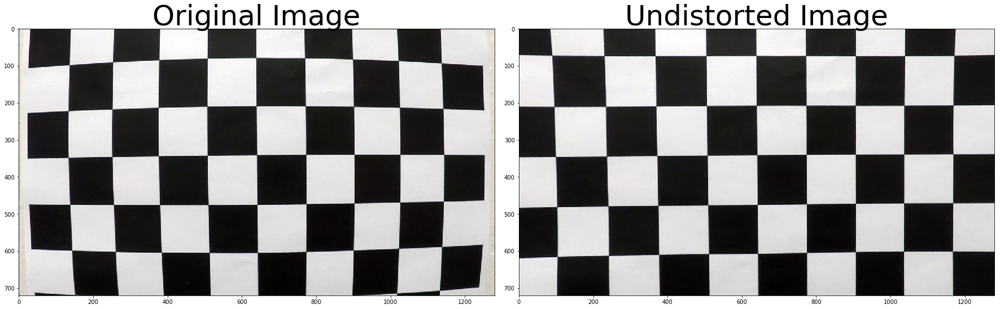

In [4]:
#  output undistorted images
# def cal_undistort(img):
    # Use cv2.calibrateCamera() and cv2.undistort()
#     gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Read in an image

img= mpimg.imread("camera_cal/calibration1.jpg")

ret,mtx,dist,revcs,tvecs = cv2.calibrateCamera(objpoints,imgpoints, \
                                                   img.shape[:2],None,None)
undistorted = cv2. undistort(img, mtx, dist, None, mtx)

show = True
if show:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)





mpimg.imsave('output_images/calibration1_distorted.jpg',img)
mpimg.imsave('output_images/calibration1_undistorted.jpg',undistorted)



# Undistort  all test images and save the last one as an example

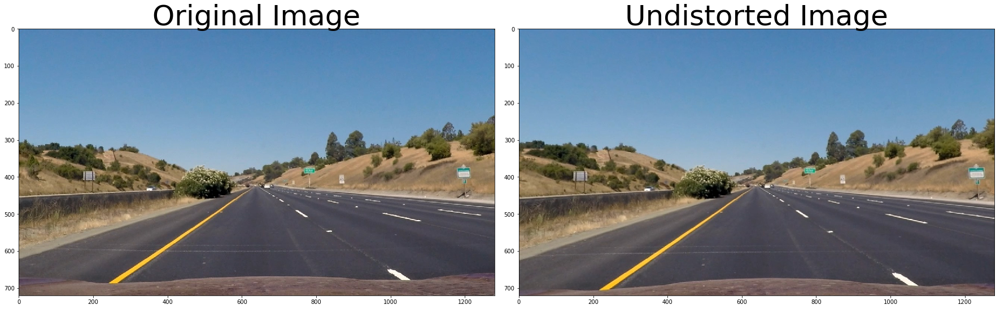

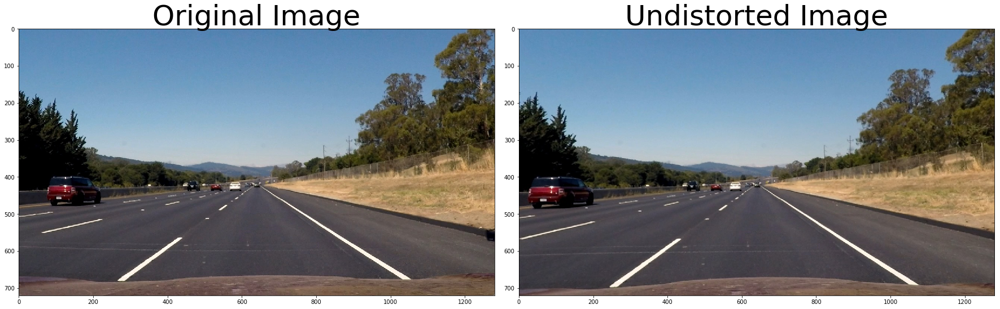

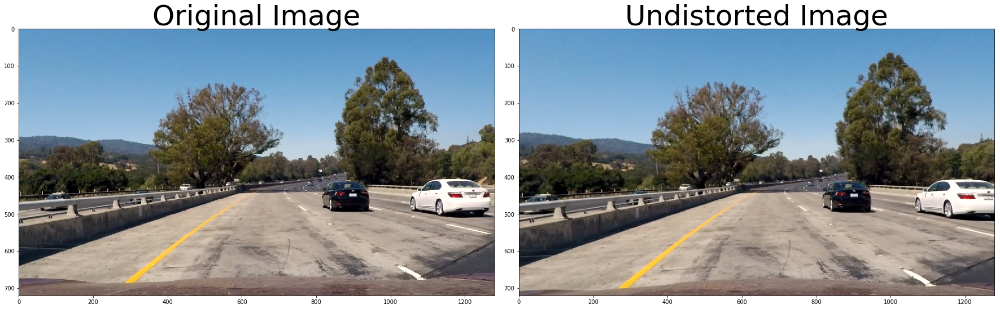

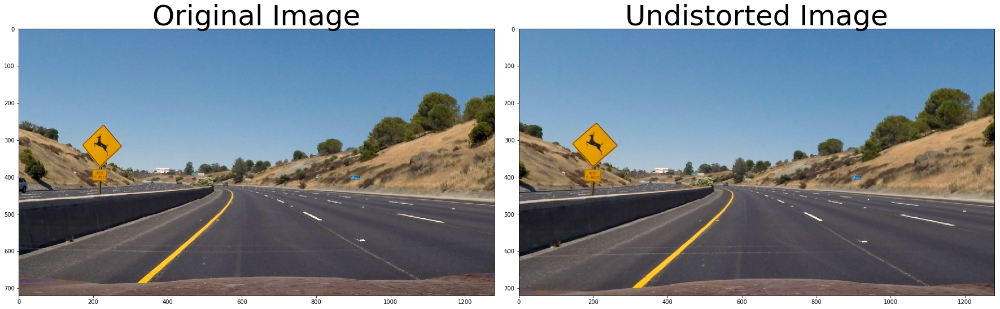

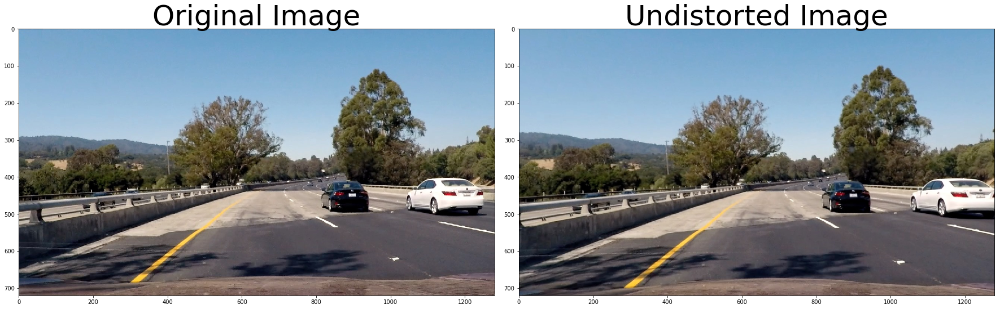

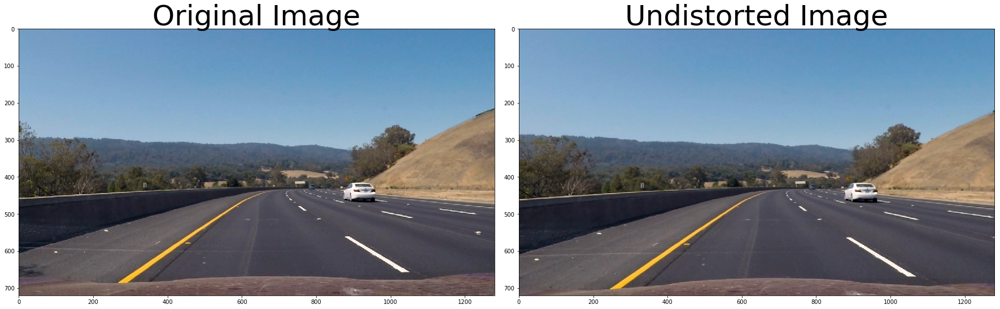

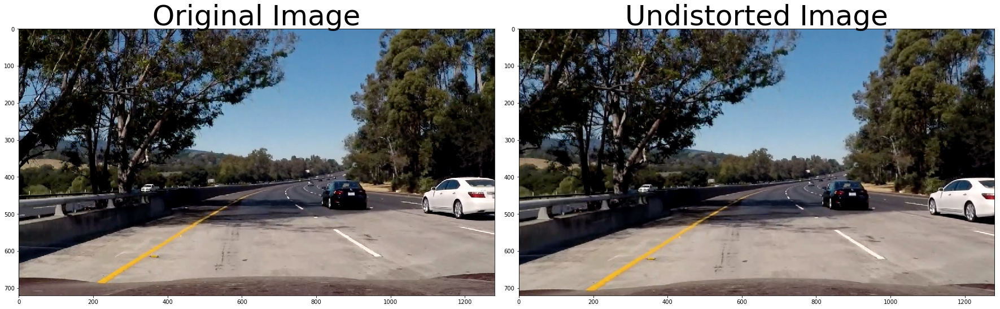

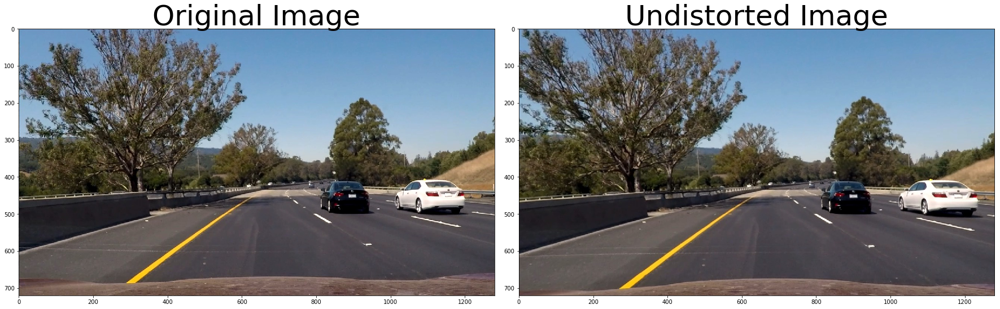

In [6]:
for img in glob.glob("test_images/*.jpg"):
    image= mpimg.imread(img)
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)
    show = True
    if show:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(undistorted)
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
mpimg.imsave('output_images/TestImage_distorted_example.jpg',image)
mpimg.imsave('output_images/TestImage_undistorted_example.jpg',undistorted)    
    

#  Apply color and gradient threshold to generate binary images

In [7]:
# functions for thresholding
# taken from class

def abs_sobel_thresh(gray, orient='x', thresh_min=5, thresh_max=100):

    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    
    scaled_sobel = np.uint8 (255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel>=thresh_min) & (scaled_sobel<=thresh_max)] = 1
    
    return binary_output

for img in glob.glob("test_images/*.jpg"):
    image= mpimg.imread(img)
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undistorted, cv2.COLOR_RGB2GRAY)
    oriention='x'
    color_binary=abs_sobel_thresh(gray,orient=oriention, thresh_min=20, thresh_max=100)
    show = False
    if show :
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undistorted)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(color_binary, cmap='gray')
        ax2.set_title('Thresholded Gradient '+ oriention, fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

In [8]:
for img in glob.glob("test_images/*.jpg"):
    image= mpimg.imread(img)
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undistorted, cv2.COLOR_RGB2GRAY)
    oriention='y'
    color_binary=abs_sobel_thresh(gray,orient=oriention, thresh_min=20, thresh_max=100)
    show = False
    if show :
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undistorted)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(color_binary, cmap='gray')
        ax2.set_title('Thresholded Gradient '+ oriention, fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [9]:
def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    
    sobelx=cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    sobely=cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    grad_dir = np.arctan2(abs_sobely,abs_sobelx)
    grad_dir = np.absolute(grad_dir)
    binary_output = np.zeros_like(grad_dir)
    binary_output[(grad_dir>=thresh[0]) & (grad_dir<=thresh[1])]=1
    return binary_output

for img in glob.glob("test_images/*.jpg"):
    image= mpimg.imread(img)
    # undistort images
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undistorted, cv2.COLOR_RGB2GRAY)
    dir_binary= dir_threshold(gray, sobel_kernel=3, thresh=(0.7, 1.3)) 
    show = False
    if show:
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undistorted)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(dir_binary, cmap='gray')
        ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


In [10]:
def hls_select(image, chanel='S', thresh=(0, 255)):

    
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    if chanel=='S':
        hls_chanel = hls[:,:,2]
    elif chanel=='L':
        hls_chanel = hls[:,:,1]
    elif chanel=='H':
        hls_chanel = hls[:,:,0]
    else :
        print('unknown chanel')
        return None
    
    binary_output = np.zeros_like(hls_chanel)
    binary_output[(hls_chanel>thresh[0]) & (hls_chanel<= thresh[1])] = 1

    return  binary_output

for img in glob.glob("test_images/*.jpg"):
    image= mpimg.imread(img)
    
    # undistort images
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)
    color_chanel ='S'
    hls_binary= hls_select(undistorted, chanel=color_chanel, thresh=(100, 255)) 
    show = False
    if show:
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undistorted)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(hls_binary, cmap='gray')
        ax2.set_title('Thresholded '+color_chanel+ ' Chanel', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


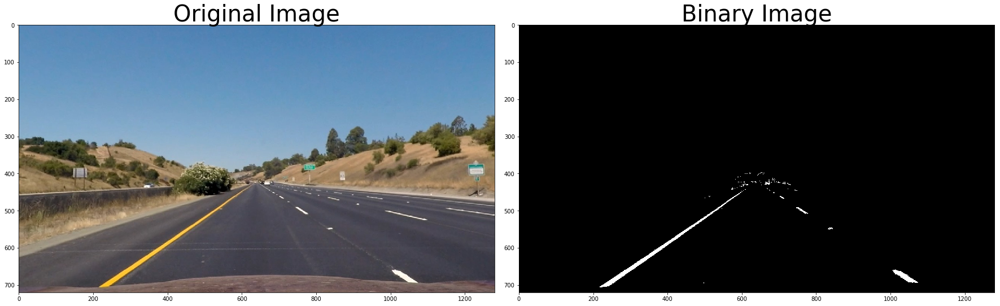

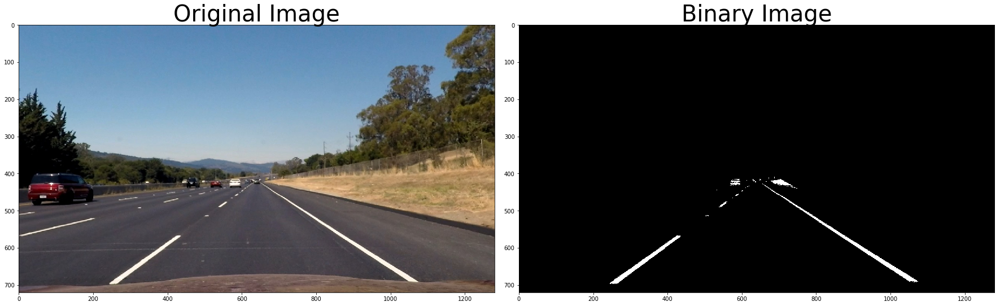

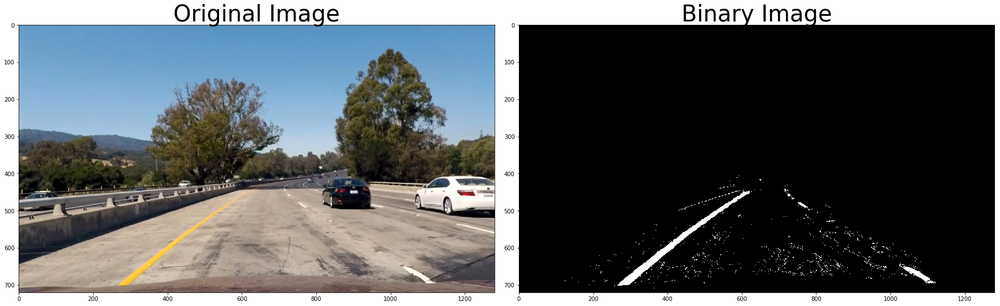

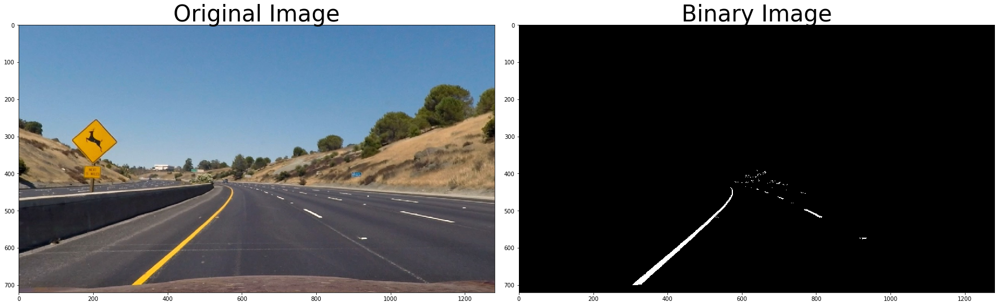

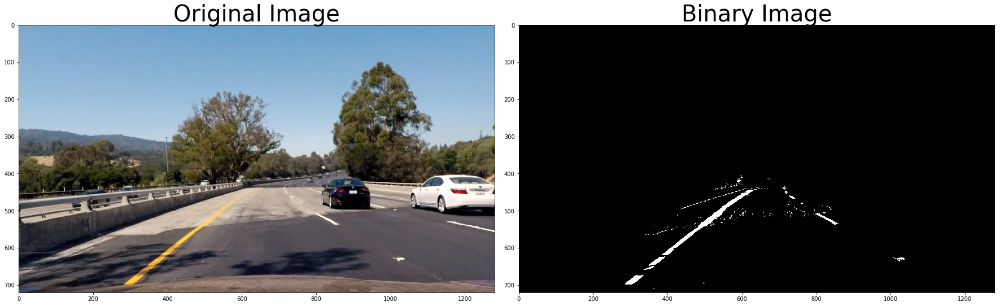

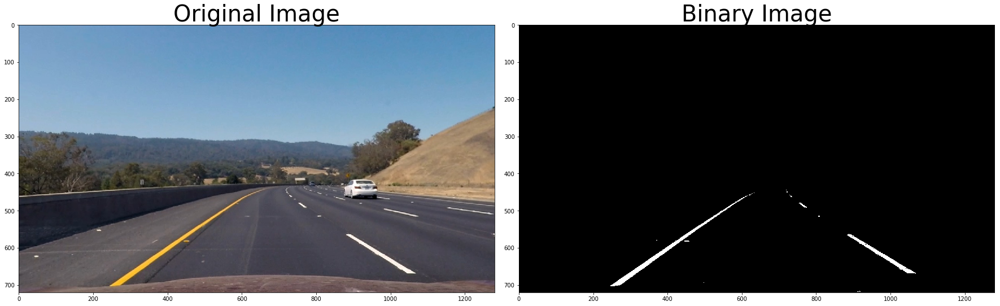

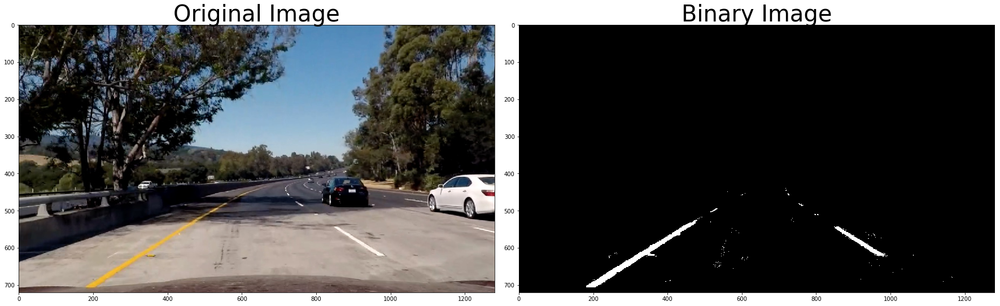

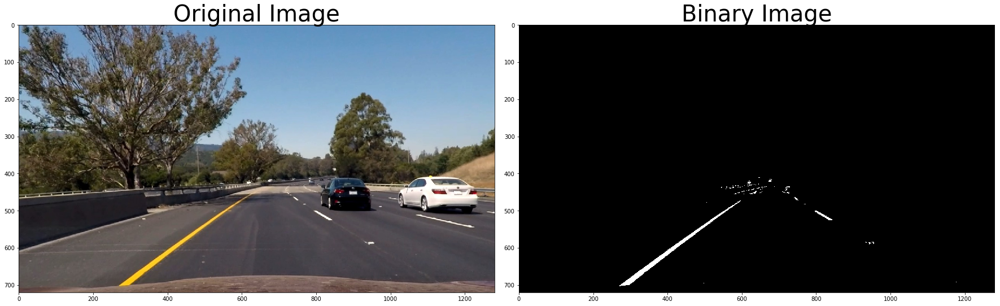

In [11]:
def generate_threshold_binary(img, s_thresh=(100, 255),l_thresh=(120, 255), sx_thresh=(10, 200), \
                              dir_thresh_bound=(np.pi/6, np.pi/2)):
    
    # convert to gray scale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    grad_x_binary=abs_sobel_thresh(gray,orient='x', thresh_min=sx_thresh[0], thresh_max=sx_thresh[1])
    
    dir_binary= dir_threshold(gray, thresh=dir_thresh_bound)
    
    s_binary= hls_select(img, chanel='S', thresh=s_thresh) 
    l_binary= hls_select(img, chanel='L', thresh=l_thresh)

    grad_binary = np.zeros_like(grad_x_binary)
    
    grad_binary[(grad_x_binary==1) & (dir_binary ==1)]  = 1
    
    
    R = img[:,:,0]
    r_thresh=(150,255)
    r_binary = np.zeros_like(R)
    r_binary[(R > r_thresh[0])& (R <= r_thresh[1])] = 1
    
    G = img[:,:,1] 
    g_thresh=(150,255)
    g_binary = np.zeros_like(G)
    g_binary[(G> g_thresh[0])& (G <= r_thresh[1])] = 1
    
    r_g_binary = np.zeros_like(G)
    r_g_binary[ (r_binary==1) & (g_binary==1)] = 1
    
    
    
    combined_binary =np.zeros_like(s_binary)
    
    combined_binary[ ( (grad_binary ==1)| (s_binary==1) ) & ( (r_g_binary==1) &(l_binary==1) )] = 1
    
    # Apply the region of interest mask
    
    mask = np.zeros_like(combined_binary)
    img_height= mask.shape[0]
    img_width = mask.shape[1]
    
    vertices = np.array([[[40, img_height], [img_width//2-20 , img_height//2+30], \
                          [img_width//2+20 ,img_height//2+30], [img_width-40 ,img_height]]],dtype = np.int32)
    
    cv2.fillPoly(mask,vertices,1)
    
    final_binary = cv2.bitwise_and(combined_binary, mask)
    
    return  final_binary

for img in glob.glob("test_images/*.jpg"):
    image= mpimg.imread(img)
    # undistort images
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)
    
    color_binary=generate_threshold_binary(undistorted)
    show = True
    if show :
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()

        ax1.imshow(undistorted)
        ax1.set_title('Original Image', fontsize=40)

        ax2.imshow(color_binary, cmap = 'gray')
        ax2.set_title('Binary Image', fontsize=40)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

# save the last one as an example

mpimg.imsave('output_images/TestImage_non_thresholded_example.jpg',undistorted)
mpimg.imsave('output_images/TestImage_binary_example.jpg',color_binary)   


#  Perspective Transformation

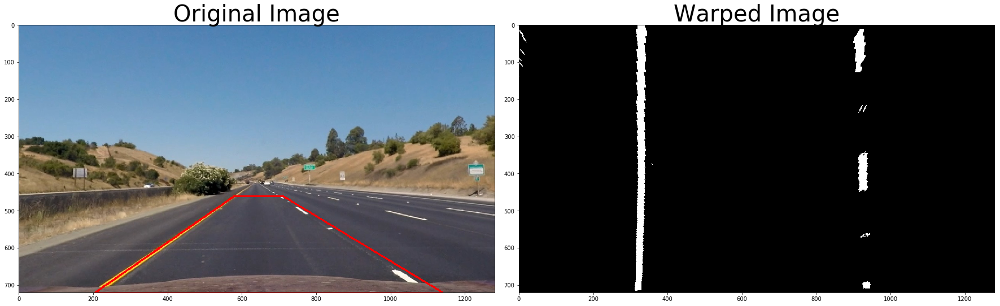

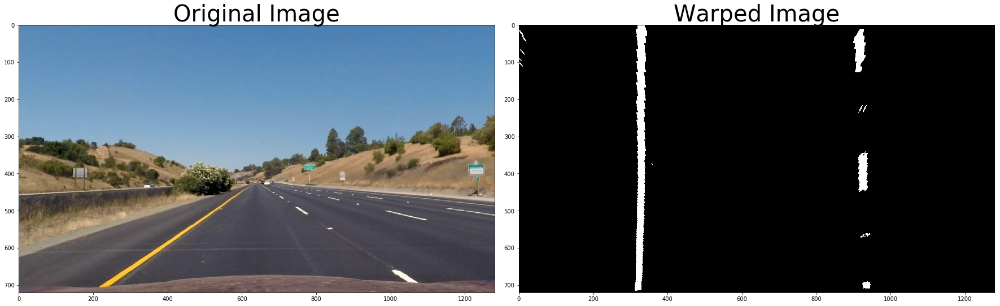

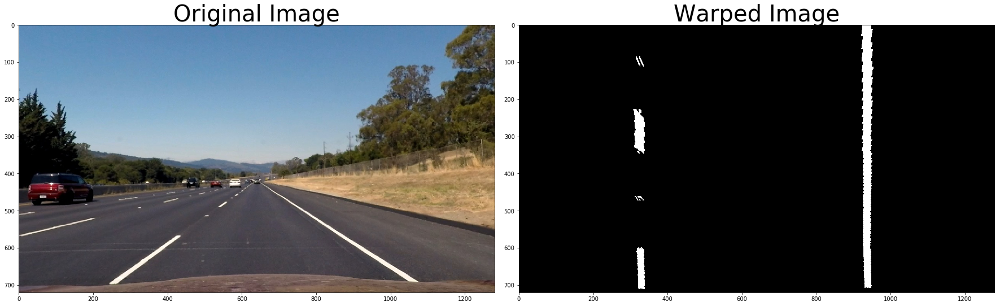

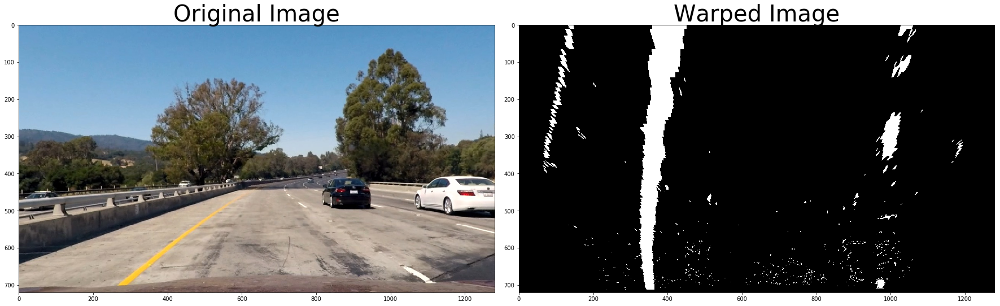

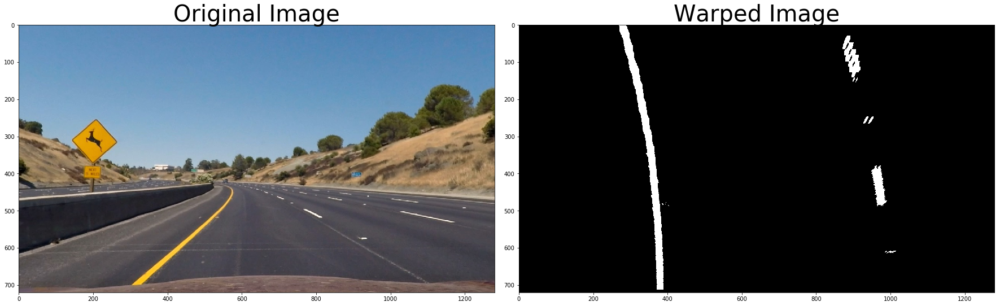

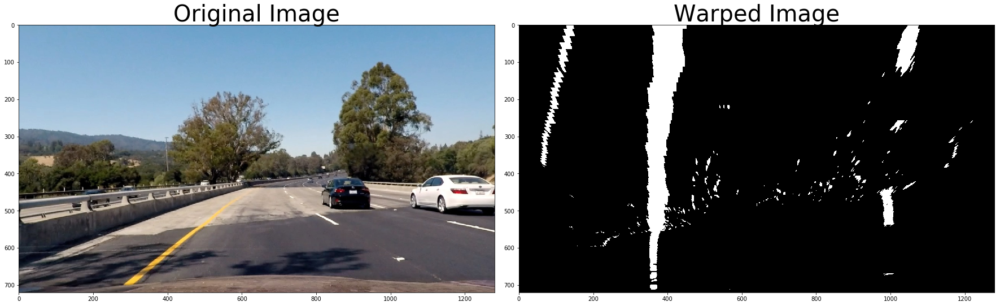

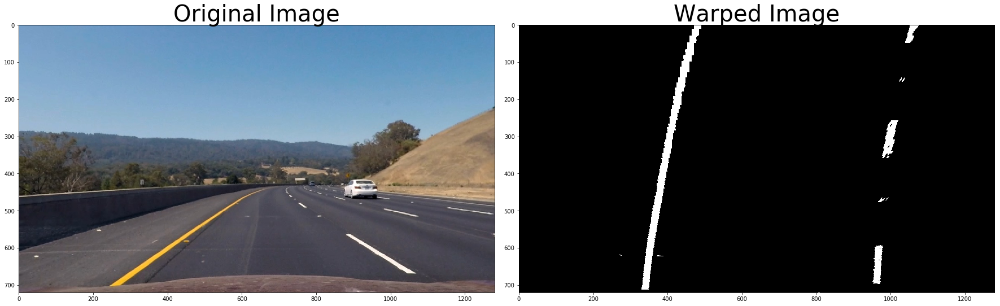

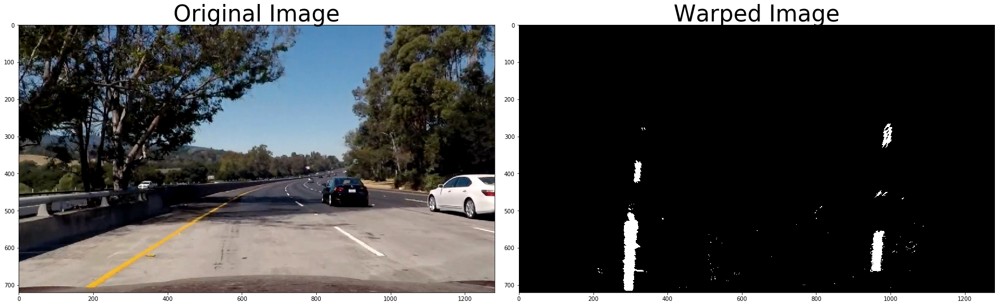

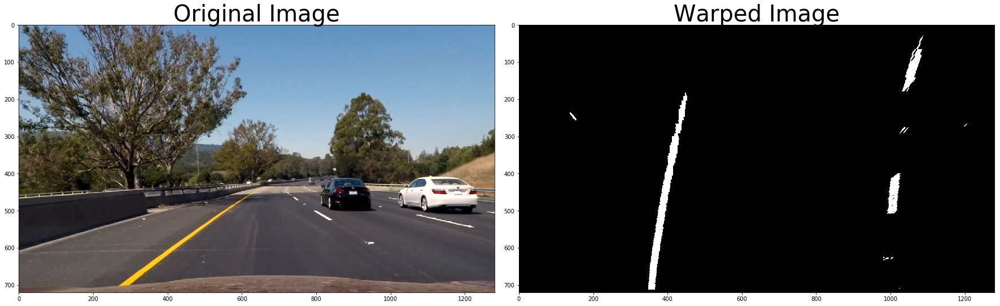

In [20]:
# perspective transformation


# 
image= mpimg.imread('test_images/straight_lines1.jpg')

# undistort images
undistorted = cv2. undistort(image, mtx, dist, None, mtx)


#  gradient_color_binary
grad_color_binary=generate_threshold_binary(undistorted)


# image size
img_size = (grad_color_binary.shape[1], grad_color_binary.shape[0])


#  Source points

left_bottom = [205,img_size[1]]
right_bottom = [img_size[0]-140, img_size[1]]
left_top = [img_size[0]//2-60 ,460]
right_top = [img_size[0]//2+70,460]
src = np.float32([left_bottom,right_bottom, right_top, left_top])

pts = np.array([left_bottom,right_bottom,right_top,left_top], np.int32)
pts = pts.reshape((-1,1,2))
cv2.polylines(undistorted,[pts],True,(255,0,0),thickness=3)


# Destination point

des_left_offset = 320
des_right_offset = 320
des_left_bottom = [des_left_offset, img_size[1]]
des_right_bottom = [img_size[0]-des_right_offset, img_size[1]]
des_left_top = [des_left_offset, 0]
des_right_top = [img_size[0]-des_right_offset, 0]
des = np.float32([des_left_bottom,des_right_bottom, des_right_top, des_left_top]) 


# Given src and dst points, calculate the perspective transform matrix
M = cv2.getPerspectiveTransform(src, des)

Minv = cv2.getPerspectiveTransform(des, src)

# Warp the image using OpenCV warpPerspective()

warped = cv2.warpPerspective(grad_color_binary, M, img_size, flags=cv2.INTER_LINEAR)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(undistorted)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(warped, cmap='gray')
ax2.set_title('Warped Image', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

save = True
if save: 
    mpimg.imsave('output_images/Image_pre_persepect_trans.jpg',undistorted)
    mpimg.imsave('output_images/Image_pos_persepect_trans.jpg',warped,cmap='gray')   

img_index =0
for img in glob.glob("test_images/*.jpg"):
    img_index+=1
    image= mpimg.imread(img)
    
    # undistort images
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)


    #  gradient_color_binary
    color_binary=generate_threshold_binary(undistorted)
    
    warped = cv2.warpPerspective(color_binary, M, img_size)
    
    # Plot the result
    show = True
    if show:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()

        ax1.imshow(undistorted)
        ax1.set_title('Original Image', fontsize=40)

        ax2.imshow(warped, cmap='gray')
        ax2.set_title('Warped Image', fontsize=40)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    save =True
    if save:    
        mpimg.imsave('output_images/Image_pre_bird_eye'+str( img_index) + '.jpg',undistorted)
        mpimg.imsave('output_images/Image_pos_bird_eye' + str( img_index) + '.jpg',warped,cmap='gray')
    

#  Histogram

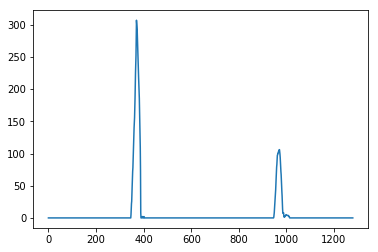

In [21]:
#  Get Histogram

def hist(img):
    #  Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    #  Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis = 0 )
    
    return histogram


# Load our image
image = mpimg.imread('test_images/test2.jpg')

# undistort images
undistorted = cv2. undistort(image, mtx, dist, None, mtx)


#  gradient_color_binary
color_binary=generate_threshold_binary(undistorted)

warped = cv2.warpPerspective(color_binary, M, img_size)


# Create histogram of image binary activations
histogram = hist(warped)

# Visualize the resulting histogram
plt.plot(histogram)

#  Sliding window search

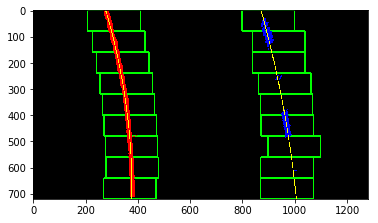

In [22]:

# configure sliding window search

# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines

midpoint = np.int(histogram.shape[0]//2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

# Set height of windows - based on nwindows above and image shape
window_height = np.int(warped.shape[0]//nwindows)

# Identify the x and y positions of all nonzero pixels in the image
nonzero = warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

# Current positions to be updated later for each window in nwindows
leftx_current = leftx_base
rightx_current = rightx_base

# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Create an output image to draw on and visualize the result
out_img = np.dstack((warped, warped, warped))*255

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = warped.shape[0] - (window+1)*window_height
    win_y_high = warped.shape[0] - window*window_height
    ### Find the four below boundaries of the window ###
    win_xleft_low = leftx_current - margin  
    win_xleft_high = leftx_current + margin  
    win_xright_low = rightx_current - margin   
    win_xright_high = rightx_current + margin
    
    
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low), \
    (win_xleft_high,win_y_high),(0,255,0), 3) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low), \
    (win_xright_high,win_y_high),(0,255,0), 3) 

    ### Identify the nonzero pixels in x and y within the window ###
    good_left_inds = ((nonzeroy>=win_y_low) & (nonzeroy<win_y_high) & \
                       (nonzerox>=win_xleft_low) & (nonzerox<win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy>=win_y_low) & (nonzeroy<win_y_high) & \
                       (nonzerox>=win_xright_low) & (nonzerox<win_xright_high)).nonzero()[0]

    nonzerox_left = np.array(good_left_inds)
    nonzerox_right = np.array(good_right_inds)

    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)

    ### If you found > minpix pixels, recenter next window ###
    ### (`right` or `leftx_current`) on their mean position ###
    if len(good_left_inds)> minpix :
        leftx_current=np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds)>minpix :
        rightx_current=np.int(np.mean(nonzerox[good_right_inds]))

            

# Concatenate the arrays of indices (previously was a list of lists of pixels)

left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)


# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]

left_fit = None
right_fit = None
    
# min_pixel_number_for_line_fitting = 5
    
### Fit a second order polynomial to each using `np.polyfit` ###
    
if len(leftx)>0:
    left_fit = np.polyfit(lefty, leftx, 2)
if len(rightx)>0:
    right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
try:
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
except TypeError:
    # Avoids an error if `left` and `right_fit` are still none or incorrect
    print('The function failed to fit a line!')
    left_fitx = 1*ploty**2 + 1*ploty
    right_fitx = 1*ploty**2 + 1*ploty
    
## Visualization ##
# Colors in the left and right lane regions
out_img[lefty, leftx] = [255, 0, 0]
out_img[righty, rightx] = [0, 0, 255]

pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.transpose(np.vstack([right_fitx, ploty]))])


# pts = np.array([[10,5],[20,30],[70,20],[50,10]], np.int32)
# pts = pts.reshape((-1,1,2))
cv2.polylines(out_img,np.int_([pts_left]),False,(255,255,0),2,8)
cv2.polylines(out_img,np.int_([pts_right]),False,(255,255,0),2,8)

# Plots the left and right polynomials on the lane lines
# out_img[ploty.astype(int), left_fitx.astype(int)] = [255, 255, 0]
# out_img[ploty.astype(int), right_fitx.astype(int)] = [255, 255, 0]
# plt.plot(left_fitx, ploty, color='yellow')
# plt.plot(right_fitx, ploty, color='yellow')    
    
plt.imshow(out_img)

mpimg.imsave('output_images/sliding_window_search_example.jpg',out_img)

#  Inverse Transform

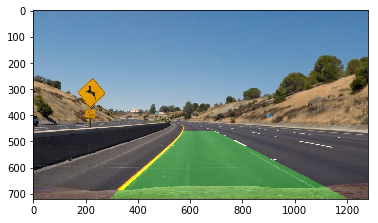

In [23]:


# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
plt.imshow(result)

#  Search around a previously detected line

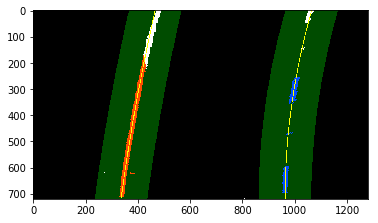

In [24]:

# Polynomial fit values from the previous frame
# Load our image
image = mpimg.imread('test_images/test3.jpg')

# undistort images
undistorted = cv2. undistort(image, mtx, dist, None, mtx)


#  gradient_color_binary
color_binary=generate_threshold_binary(undistorted)

binary_warped = cv2.warpPerspective(color_binary, M, img_size)
    
# HYPERPARAMETER
# Choose the width of the margin around the previous polynomial to search
margin = 100

# Grab activated pixels
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

### Set the area of search based on activated x-values ###
### within the +/- margin of our polynomial function ###
left_lane_inds = ((nonzerox>left_fit[0]*nonzeroy**2 + left_fit[1]*nonzeroy+ left_fit[2]-margin) & \
(nonzerox<left_fit[0]*nonzeroy**2 + left_fit[1]*nonzeroy+left_fit[2]+margin)).nonzero()[0]
right_lane_inds = ((nonzerox>right_fit[0]*nonzeroy**2 + right_fit[1]*nonzeroy+right_fit[2]-margin) & \
(nonzerox<right_fit[0]*nonzeroy**2 + right_fit[1]*nonzeroy+right_fit[2]+margin)).nonzero()[0]

# extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
    
    
left_fit = None
right_fit = None

# min_pixel_number_for_line_fitting = 5

 ### Fit a second order polynomial to each using `np.polyfit` ###

if len(leftx)>0:
    left_fit = np.polyfit(lefty, leftx, 2)
if len(rightx)>0:
    right_fit = np.polyfit(righty, rightx, 2)    



# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])

try:
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
except TypeError:
    # Avoids an error if `left` and `right_fit` are still none or incorrect
    print('The function failed to fit a line!')
    left_fitx = 1*ploty**2 + 1*ploty
    right_fitx = 1*ploty**2 + 1*ploty

    
## Visualization ##
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[lefty, leftx] = [255, 0, 0]
out_img[righty, rightx] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                          ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                          ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

# Plot the polynomial lines onto the image
# plt.plot(left_fitx, ploty, color='yellow')
# plt.plot(right_fitx, ploty, color='yellow')

pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.transpose(np.vstack([right_fitx, ploty]))])

cv2.polylines(result,np.int_([pts_left]),False,(255,255,0),2,8)
cv2.polylines(result,np.int_([pts_right]),False,(255,255,0),2,8)

# fig = plt.gcf()
# result = cv2.addWeighted(result, 1, fig, 0.3, 0)
# py.plot_mpl(fig, filename='polynomial-Fit-with-matplotlib')
## End visualization steps ##

# View your output
plt.imshow(result)

mpimg.imsave('output_images/search_around_poly_example.jpg',result)

# Compute the radius of curvature and center offset

In [25]:



# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension



left_fit_cr = np.array([left_fit[0]*xm_per_pix/(ym_per_pix**2),left_fit[1]*xm_per_pix/ym_per_pix,left_fit[2]*xm_per_pix ]) 
right_fit_cr = np.array([right_fit[0]*xm_per_pix/(ym_per_pix**2),right_fit[1]*xm_per_pix/ym_per_pix,right_fit[2]*xm_per_pix ]) 
        
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])


# Define y-value where we want radius of curvature
# We'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(ploty)
    
##### Implement the calculation of R_curve (radius of curvature) #####
left_curverad = ((1+(2*left_fit_cr[0]*y_eval*ym_per_pix+left_fit_cr[1])**2 )**(3/2))/(2*left_fit_cr[0])  ## Implement the calculation of the left line 
right_curverad =  ((1+(2*right_fit_cr[0]*y_eval*ym_per_pix+right_fit_cr[1])**2 )**(3/2))/(2*right_fit_cr[0])   ## Implement the calculation of the right line 

average_curverad = (left_curverad + right_curverad)/2
# Calculate the center offset 

try:
    left_fitx_eval = (left_fit_cr[0]*(y_eval**2)*(ym_per_pix**2) + left_fit_cr[1]*y_eval*ym_per_pix  \
                           + left_fit_cr[2])
    right_fitx_eval = (right_fit_cr[0]*(y_eval**2)*(ym_per_pix**2) + right_fit_cr[1]*y_eval*ym_per_pix \
                           + right_fit_cr[2])
except TypeError:
# Avoids an error if `left` and `right_fit` are still none or incorrect
    print('The function failed to fit a line!')
    left_fitx_eval = 1*(y_eval**2)*(ym_per_pix**2) + 1*y_eval*ym_per_pix
    right_fitx_eval = 1*(y_eval**2)*(ym_per_pix**2) + 1*y_eval*ym_per_pix

lane_center = (left_fitx_eval+right_fitx_eval)/2

center_offset = abs(lane_center-result.shape[1]/2*xm_per_pix)
    

print('Radius of Curvature:',average_curverad, 'm')

print("Center Offset:", center_offset, 'm')


Radius of Curvature: 1711.14029386 m
Center Offset: 0.0511655091285 m


#  Inverse Transform

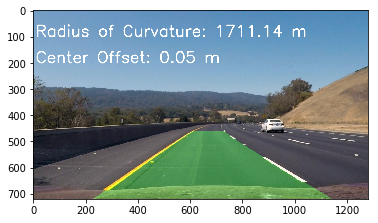

In [26]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

curve_rad_text = 'Radius of Curvature: {0:.2f} m '.format(average_curverad)
center_offset_text = 'Center Offset: {0:.2f} m '.format(center_offset)

font = cv2.FONT_HERSHEY_SIMPLEX
cv2.putText(result,curve_rad_text,(10,100), font, 2,(255,255,255),3,cv2.LINE_AA)
cv2.putText(result,center_offset_text,(10,200), font, 2,(255,255,255),3,cv2.LINE_AA)
plt.imshow(result)

mpimg.imsave('output_images/inverse_transform_example.jpg',result)

#  Pipeline for finding lane line 

In [35]:
def sliding_window_pip(warped):
    
    # Create histogram of image binary activations
    histogram = hist(warped)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines

    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(warped.shape[0]//nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Create an output image to draw on and visualize the result
    out_img = np.dstack((warped, warped, warped))

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = warped.shape[0] - (window+1)*window_height
        win_y_high = warped.shape[0] - window*window_height
        ### Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin  
        win_xright_low = rightx_current - margin   
        win_xright_high = rightx_current + margin
    
    


        ### Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy>=win_y_low) & (nonzeroy<win_y_high) & \
                           (nonzerox>=win_xleft_low) & (nonzerox<win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy>=win_y_low) & (nonzeroy<win_y_high) & \
                           (nonzerox>=win_xright_low) & (nonzerox<win_xright_high)).nonzero()[0]

        nonzerox_left = np.array(good_left_inds)
        nonzerox_right = np.array(good_right_inds)

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        ### If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds)> minpix :
            leftx_current=np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds)>minpix :
            rightx_current=np.int(np.mean(nonzerox[good_right_inds]))



    # Concatenate the arrays of indices (previously was a list of lists of pixels)

    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)


    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    left_fit = None
    right_fit = None

    # min_pixel_number_for_line_fitting = 5

    ### Fit a second order polynomial to each using `np.polyfit` ###

    if len(leftx)>0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx)>0:
        right_fit = np.polyfit(righty, rightx, 2)
        
    return left_fit, right_fit
    
    



def search_around_poly_pip(binary_warped, pre_left_fit,pre_right_fit):
    
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    left_lane_inds = ((nonzerox>pre_left_fit[0]*nonzeroy**2 + pre_left_fit[1]*nonzeroy+ pre_left_fit[2]-margin) & \
    (nonzerox<pre_left_fit[0]*nonzeroy**2 + pre_left_fit[1]*nonzeroy+pre_left_fit[2]+margin)).nonzero()[0]
    right_lane_inds = ((nonzerox>pre_right_fit[0]*nonzeroy**2 + pre_right_fit[1]*nonzeroy+pre_right_fit[2]-margin) & \
    (nonzerox<pre_right_fit[0]*nonzeroy**2 + pre_right_fit[1]*nonzeroy+pre_right_fit[2]+margin)).nonzero()[0]
    
    # extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    
    left_fit = None
    right_fit = None
    
     ### Fit a second order polynomial to each using `np.polyfit` ###
    
    if len(leftx)>0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx)>0:
        right_fit = np.polyfit(righty, rightx, 2)    

    return left_fit, right_fit









# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # polynomial coefficients for the n iterations
        self.recent_fit = []   
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit =  [np.array([False])]
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        # the last n fitted : valid--1; invalid--0
        self.recent_fit_valid = []



        
def finding_lane_pipeline(image):
    
    # undistort images
    undistorted = cv2. undistort(image, mtx, dist, None, mtx)


    #  gradient_color_binary
    color_binary=generate_threshold_binary(undistorted)
    
    
    image_shape = image.shape
    img_size = (image_shape[1], image_shape[0])
    
    # Perspective transformation matrix M are global variabl
    warped = cv2.warpPerspective(color_binary, M, img_size)

    
    # if both lines are detected in the previous frame, use search_around_poly to find lines in the current 
    # frame; otherwise, use sliding window search
    
    if (leftline.detected == True)  & (rightline.detected == True ) :
        
        left_fit, right_fit=search_around_poly_pip(warped,leftline.best_fit, rightline.best_fit)
                            
        did_sliding_window = False    
        

    else:
        left_fit, right_fit = sliding_window_pip(warped)
        
        did_sliding_window = True
        
        
    leftline.detected = True
    rightline.detected = True


    
    #  Desired line distance
    
    Desired_line_distance = 650
        
    if ((left_fit == None)| (right_fit == None) )  & (did_sliding_window == False) : 
        
        left_fit, right_fit = sliding_window_pip(warped)
        
        did_sliding_window = True
            
    if (left_fit == None) | (right_fit == None) :
        
        leftline.current_fit = None
        rightline.current_fit = None
        
        leftline.detected = False
        
        rightline.detected = False
         
        
    else: 
        
        # calculate the line distance at the bottom of the image
        y_eval= warped.shape[0]
        
        left_fitx = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
        right_fitx = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
        
        if  abs(right_fitx-left_fitx-Desired_line_distance)>200:
            
            if did_sliding_window == False :
            
                left_fit, right_fit = sliding_window_pip(warped)
            
                did_sliding_window = True
            
                if (left_fit == None) | (right_fit == None) :
                
                    leftline.current_fit = None
                    rightline.current_fit = None
            
                    leftline.detected = False
        
                    rightline.detected = False
                else:
                
                    left_fitx = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
                    right_fitx = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]



        if abs(right_fitx-left_fitx-Desired_line_distance)>200 :

            leftline.current_fit = None
            rightline.current_fit = None

            leftline.detected = False

            rightline.detected = False

        else:

            leftline.current_fit = left_fit
            rightline.current_fit = right_fit



            leftline.recent_fit.append(left_fit)
            rightline.recent_fit.append(right_fit)

            leftline.recent_fit_valid.append(1)



            if len(leftline.recent_fit_valid) > 10 :
                if leftline.recent_fit_valid[0] ==1 :
                # Get rid of the oldest one

                    leftline.recent_fit = leftline.recent_fit[1:]
                    rightline.recent_fit = rightline.recent_fit[1:]
                leftline.recent_fit_valid = leftline.recent_fit_valid [1:]


            leftline.best_fit = np.average(leftline.recent_fit, axis=0)
            rightline.best_fit = np.average(rightline.recent_fit, axis=0)
            
          

    if leftline.current_fit == None:

        
        if leftline.best_fit == None:
            return image
            
        else:
            left_fit = leftline.best_fit
            right_fit = rightline.best_fit
            
        leftline.recent_fit_valid.append(0)
        
        if len(leftline.recent_fit_valid) > 10 :
            if leftline.recent_fit_valid[0] ==1 :
                # Get rid of the oldest one
                
                leftline.recent_fit = leftline.recent_fit[1:]
                rightline.recent_fit = rightline.recent_fit[1:]
            leftline.recent_fit_valid = leftline.recent_fit_valid [1:]
            
        if len(leftline.recent_fit) > 0:
            
            leftline.best_fit = np.average(leftline.recent_fit, axis=0)
            rightline.best_fit = np.average(rightline.recent_fit, axis=0)
            
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))        
    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])

    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

     
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    left_fit_cr = np.array([left_fit[0]*xm_per_pix/(ym_per_pix**2),left_fit[1]*xm_per_pix/ym_per_pix,left_fit[2]*xm_per_pix ]) 
    right_fit_cr = np.array([right_fit[0]*xm_per_pix/(ym_per_pix**2),right_fit[1]*xm_per_pix/ym_per_pix,right_fit[2]*xm_per_pix ]) 
    



    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    ##### Implement the calculation of R_curve (radius of curvature) #####
    left_curverad = ((1+(2*left_fit_cr[0]*y_eval*ym_per_pix+left_fit_cr[1])**2 )**(3/2))/(2*left_fit_cr[0])  ## Implement the calculation of the left line 
    right_curverad =  ((1+(2*right_fit_cr[0]*y_eval*ym_per_pix+right_fit_cr[1])**2 )**(3/2))/(2*right_fit_cr[0])   ## Implement the calculation of the right line 

    average_curverad = (left_curverad + right_curverad)/2
    
    # Calculate the center offset 

    left_fitx_eval = (left_fit_cr[0]*(y_eval**2)*(ym_per_pix**2) + left_fit_cr[1]*y_eval*ym_per_pix  \
                           + left_fit_cr[2])
    right_fitx_eval = (right_fit_cr[0]*(y_eval**2)*(ym_per_pix**2) + right_fit_cr[1]*y_eval*ym_per_pix \
                           + right_fit_cr[2])


    lane_center = (left_fitx_eval+right_fitx_eval)/2

    center_offset = abs(lane_center-result.shape[1]/2*xm_per_pix)
    curve_rad_text = 'Radius of Curvature: {0:.2f} m '.format(average_curverad)
    center_offset_text = 'Center Offset: {0:.2f} m '.format(center_offset)
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result,curve_rad_text,(10,100), font, 2,(255,255,255),3,cv2.LINE_AA)
    cv2.putText(result,center_offset_text,(10,200), font, 2,(255,255,255),3,cv2.LINE_AA)
    
    
    
    return result
            
            
        
        
            
            
            

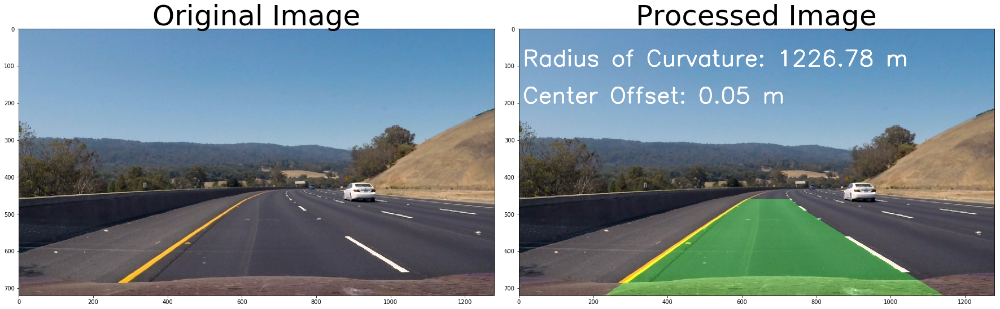

In [36]:
# Load our image
img = mpimg.imread('test_images/test3.jpg')
                   
leftline = Line()
rightline = Line()   



# Apply pipeline
processed = finding_lane_pipeline(img)

# print(leftline.current_fit)

# Plot the 2 images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(processed, cmap='gray')
ax2.set_title('Processed Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


In [37]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip

leftline = Line()
rightline = Line()

video_output= 'project_video_output.mp4'
video_input =   VideoFileClip('project_video.mp4') #.subclip(0,10)

processed_video = video_input.fl_image(finding_lane_pipeline)
%time processed_video.write_videofile(video_output, audio=False)


[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [05:57<00:00,  3.53it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 3min 49s, sys: 664 ms, total: 3min 49s
Wall time: 6min


In [38]:
from IPython.display import HTML

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

In [39]:
leftline = Line()
rightline = Line()

video_output1 = 'challenge_video_output.mp4'
video_input1 = VideoFileClip('challenge_video.mp4')
processed_video = video_input1.fl_image(finding_lane_pipeline)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [02:16<00:00,  3.57it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 1min 28s, sys: 290 ms, total: 1min 28s
Wall time: 2min 19s


In [40]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output1))

In [33]:
leftline = Line()
rightline = Line()

video_output2 = 'harder_challenge_video_output.mp4'
video_input2 = VideoFileClip('harder_challenge_video.mp4')
processed_video = video_input2.fl_image(finding_lane_pipeline)
%time processed_video.write_videofile(video_output2, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [06:42<00:00,  2.95it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 4min 4s, sys: 683 ms, total: 4min 5s
Wall time: 6min 46s


In [34]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output2))